# Домашнее задание № 0
Вам необходимо провести анализ данных и с помощью него ответить на поставленные вопросы. 

# Исходные данные
Этот набор данных представляет собой описание около 1 миллиона треков с платформы Spotify. Скачайте датасет и ознакомьтесь с описанием данных в [источнике](https://www.kaggle.com/datasets/amitanshjoshi/spotify-1million-tracks/data).

In [2]:
import pandas as pd

In [4]:
# Читаем данные
path = 'spotify_data.csv'
df = pd.read_csv(path, index_col=0)

In [6]:
df.sample(3).T

,576503,1274466,280834
artist_name,João Gilberto,Municipal Waste,The Scorpios
track_name,Presente de Natal,The Wrath of the Severed Head,La Shaftak Tabel Elshoog
track_id,2uM3Pn7g89cm3f9jfsRO6A,7GgOThIO6M4ssuEFmcL3q2,5mwzL4pntGRgyhLf0VyQub
popularity,7,17,9
year,2022,2009,2017
genre,samba,death-metal,groove
danceability,0.639,0.38,0.577
energy,0.0785,0.993,0.214
key,2,8,7
loudness,-18.547,-4.202,-17.923


# Вопросы

## Анализ данных
С помощью работы с типом данных DataFrame из библиотеки pandas ответье на поставленные вопросы

In [10]:
# YOUR IMPORTS HERE
import numpy as np

### 1. Сколько уникальных исполнителей и сколько уникальных жанров содержится в датасете?

**Результат**: Код и текстовый ответ на вопрос в формате

```
Уникальных исполнителей: <ответ>
Уникальных жанров: <ответ>
```

In [13]:
# YOUR CODE HERE
uniq_art = df['artist_name'].nunique()
uniq_gen = df['genre'].nunique()

print(f"Уникальных исполнителей: {uniq_art}")
print(f"Уникальных жанров: {uniq_gen}")

Уникальных исполнителей: 64158
Уникальных жанров: 82


### 2. Есть ли в данных пропуски? Если да, предложите способ их заполнения и реализуйте его

**Результат**: Код и текстовый ответ на вопрос в формате

```
Для каждого столбца в таблице
<Название столбца> - <Сколько пропусков> - <Описание способа заполнения> (Если были пропуски)
```


In [16]:
# YOUR CODE HERE
for col in df.columns:
    miss_cnt = df[col].isnull().sum()
    if miss_cnt > 0:
        if df[col].dtype in ['float64', 'int64']:
            fill_val = df[col].median()
            df.loc[df[col].isnull(), col] = fill_val
            print(f"{col} - {miss_cnt} - Заполнено медианой ({fill_val})")
        else:
            fill_val = df[col].mode()[0] if not df[col].mode().empty else 'Unknown'
            df.loc[df[col].isnull(), col] = fill_val
            print(f"{col} - {miss_cnt} - Заполнено модой ({fill_val})")
    else:
        print(f"{col} - 0 - Пропусков нет")

artist_name - 15 - Заполнено модой (Traditional)
track_name - 1 - Заполнено модой (Intro)
track_id - 0 - Пропусков нет
popularity - 0 - Пропусков нет
year - 0 - Пропусков нет
genre - 0 - Пропусков нет
danceability - 0 - Пропусков нет
energy - 0 - Пропусков нет
key - 0 - Пропусков нет
loudness - 0 - Пропусков нет
mode - 0 - Пропусков нет
speechiness - 0 - Пропусков нет
acousticness - 0 - Пропусков нет
instrumentalness - 0 - Пропусков нет
liveness - 0 - Пропусков нет
valence - 0 - Пропусков нет
tempo - 0 - Пропусков нет
duration_ms - 0 - Пропусков нет
time_signature - 0 - Пропусков нет


### 3. Есть ли признаки, которые не отвечают указанным в описании ограничениям? Если есть, то замените их

**Результат**: Код и текстовый ответ на вопрос в формате

```
Для каждого столбца в таблице
<Название столбца> - <Сколько не соответствующих ограничениям данных> - <Описание способа замены> (Если были некорректные данные)
```

In [19]:
# YOUR CODE HERE
# Популярность
pop_out = df[(df['popularity'] < 0) | (df['popularity'] > 100)].shape[0]
if pop_out > 0:
    df['popularity'] = df['popularity'].clip(0, 100)
    print(f"popularity - {pop_out} - Ограничено 0-100")

# Год
yr_out = df[(df['year'] < 1900) | (df['year'] > 2023)].shape[0]
if yr_out > 0:
    df = df[(df['year'] >= 1900) & (df['year'] <= 2023)]
    print(f"year - {yr_out} - Удалены вне 1900-2023")

# Параметры
for col in ['danceability', 'energy', 'speechiness', 'acousticness', 'instrumentalness', 'liveness', 'valence']:
    out_cnt = df[(df[col] < 0) | (df[col] > 1)].shape[0]
    if out_cnt > 0:
        df[col] = df[col].clip(0, 1)
        print(f"{col} - {out_cnt} - Ограничено 0-1")

# Ключ
key_out = df[(df['key'] < 0) | (df['key'] > 11)].shape[0]
if key_out > 0:
    df['key'] = df['key'].clip(0, 11)
    print(f"key - {key_out} - Ограничено 0-11")

# Лад
mode_out = df[(df['mode'] < 0) | (df['mode'] > 1)].shape[0]
if mode_out > 0:
    df['mode'] = df['mode'].clip(0, 1)
    print(f"mode - {mode_out} - Ограничено 0-1")

# Размер
ts_out = df[~df['time_signature'].isin([3, 4, 5, 6, 7])].shape[0]
if ts_out > 0:
    df = df[df['time_signature'].isin([3, 4, 5, 6, 7])]
    print(f"time_signature - {ts_out} - Удалены нестандартные")

time_signature - 13888 - Удалены нестандартные


## Визуальный анализ
Ответом на вопрос должен быть график или несколько графиков в одной фигуре (картинке), с минимальной подписью

In [22]:
# YOUR IMPORTS HERE
import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
import plotly.graph_objects as go
from plotly.subplots import make_subplots

plt.style = 'seaborn'

### 1. Как Energy зависит от Danceability? Как зависит Loudness от Energy? Как эти параметры влияют на Valence?

**Результат**: Код, реализующий графики:

- Зависимость Energy от Danceability
- Зависимость Loudness от Energy
- Зависимость Valence от Energy, зависимость Valence от Danceability; в одной оси фигуры
- Зависимость Valence от Loudness
- Матрица корреляции Energy, Danceability, Loudness, Valence

Каждый график должен иметь название, подписанные оси и, при необходимости, легенду.

**Дополнительно**: Нарисовать стрелки и подписи к ним на графике, обращающие внимание на ключевые моменты, позволяющие сделать выводы о зависимостях. 

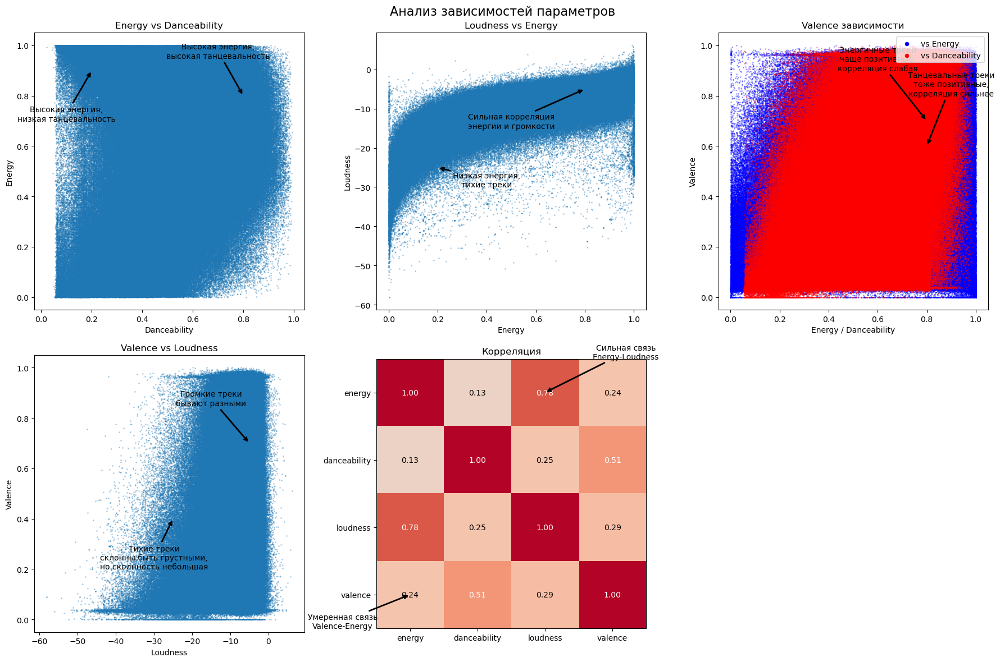

In [25]:
# YOUR CODE HERE
fig, axs = plt.subplots(2, 3, figsize=(18, 12))
fig.suptitle('Анализ зависимостей параметров', fontsize=16)

# Energy vs Danceability
axs[0, 0].scatter(df['danceability'], df['energy'], alpha=0.3, s=1)
axs[0, 0].set_xlabel('Danceability')
axs[0, 0].set_ylabel('Energy')
axs[0, 0].set_title('Energy vs Danceability')

axs[0, 0].annotate('Высокая энергия,\nнизкая танцевальность', 
                  xy=(0.2, 0.9), xytext=(0.1, 0.7),
                  arrowprops=dict(arrowstyle='->', color='black', lw=2),
                  fontsize=10, ha='center')
axs[0, 0].annotate('Высокая энергия,\nвысокая танцевальность', 
                  xy=(0.8, 0.8), xytext=(0.7, 0.95),
                  arrowprops=dict(arrowstyle='->', color='black', lw=2),
                  fontsize=10, ha='center')

# Loudness vs Energy
axs[0, 1].scatter(df['energy'], df['loudness'], alpha=0.3, s=1)
axs[0, 1].set_xlabel('Energy')
axs[0, 1].set_ylabel('Loudness')
axs[0, 1].set_title('Loudness vs Energy')

axs[0, 1].annotate('Сильная корреляция\nэнергии и громкости', 
                  xy=(0.8, -5), xytext=(0.5, -15),
                  arrowprops=dict(arrowstyle='->', color='black', lw=2),
                  fontsize=10, ha='center')
axs[0, 1].annotate('Низкая энергия,\nтихие треки', 
                  xy=(0.2, -25), xytext=(0.4, -30),
                  arrowprops=dict(arrowstyle='->', color='black', lw=2),
                  fontsize=10, ha='center')

# Valence vs Energy и Danceability
sc1 = axs[0, 2].scatter([], [], alpha=1, s=20, color='blue', label='vs Energy')
sc2 = axs[0, 2].scatter([], [], alpha=1, s=20, color='red', label='vs Danceability')
axs[0, 2].scatter(df['energy'], df['valence'], alpha=0.3, s=1, color='blue')
axs[0, 2].scatter(df['danceability'], df['valence'], alpha=0.3, s=1, color='red')
axs[0, 2].set_xlabel('Energy / Danceability')
axs[0, 2].set_ylabel('Valence')
axs[0, 2].set_title('Valence зависимости')
axs[0, 2].legend(loc='upper right')

axs[0, 2].annotate('Энергичные треки\nчаще позитивные,\nкорреляция слабая', 
                  xy=(0.8, 0.7), xytext=(0.6, 0.9),
                  arrowprops=dict(arrowstyle='->', color='black', lw=2),
                  fontsize=10, ha='center', color='black')
axs[0, 2].annotate('Танцевальные треки\nтоже позитивные,\nкорреляция сильнее', 
                  xy=(0.8, 0.6), xytext=(0.9, 0.8),
                  arrowprops=dict(arrowstyle='->', color='black', lw=2),
                  fontsize=10, ha='center', color='black')

# Valence vs Loudness
axs[1, 0].scatter(df['loudness'], df['valence'], alpha=0.3, s=1)
axs[1, 0].set_xlabel('Loudness')
axs[1, 0].set_ylabel('Valence')
axs[1, 0].set_title('Valence vs Loudness')

axs[1, 0].annotate('Громкие треки\nбывают разными', 
                  xy=(-5, 0.7), xytext=(-15, 0.85),
                  arrowprops=dict(arrowstyle='->', color='black', lw=2),
                  fontsize=10, ha='center')
axs[1, 0].annotate('Тихие треки\nсклонны быть грустными,\nно сколнность небольшая', 
                  xy=(-25, 0.4), xytext=(-30, 0.2),
                  arrowprops=dict(arrowstyle='->', color='black', lw=2),
                  fontsize=10, ha='center')

# Матрица корреляции
corr_mat = df[['energy', 'danceability', 'loudness', 'valence']].corr()
im = axs[1, 1].imshow(corr_mat, cmap='coolwarm', vmin=-1, vmax=1)
axs[1, 1].set_xticks(range(len(corr_mat.columns)))
axs[1, 1].set_yticks(range(len(corr_mat.columns)))
axs[1, 1].set_xticklabels(corr_mat.columns)
axs[1, 1].set_yticklabels(corr_mat.columns)
axs[1, 1].set_title('Корреляция')

for i in range(len(corr_mat.columns)):
    for j in range(len(corr_mat.columns)):
        axs[1, 1].text(j, i, f'{corr_mat.iloc[i, j]:.2f}', 
                       ha='center', va='center', color='white' if abs(corr_mat.iloc[i, j]) > 0.5 else 'black')

axs[1, 1].annotate('Сильная связь\nEnergy-Loudness', 
                  xy=(2, 0), xytext=(3.2, -0.5),
                  arrowprops=dict(arrowstyle='->', color='black', lw=2),
                  fontsize=10, ha='center')
axs[1, 1].annotate('Умеренная связь\nValence-Energy', 
                  xy=(0, 3), xytext=(-1, 3.5),
                  arrowprops=dict(arrowstyle='->', color='black', lw=2),
                  fontsize=10, ha='center')

axs[1, 2].axis('off')

plt.tight_layout()
plt.show()

#### Сделайте общий вывод о том, зависит ли настроение трека (Valence) от проанализированных параметров:
**Результат**: Текстовый ответ на вопрос.

*Настроение трека слабо коррелирует с проанализированными параметрами (максимально - с danceability - ~0.5). Настроение зависит от многих факторов, и трудно выделить 1-2 самых важных*

### 2. С годами музыка становится дольше или быстрее?

**Результат**: Код, реализующий графики:

- Зависимость средней продолжительности трека от года, с линией тренда
- Изменение средней продолжительности топ-5 самых длинных треков года
- Изменение средней продолжительности топ-5 самых коротких треков года

Каждый график должен иметь название, подписанные оси и, при необходимости, легенду.

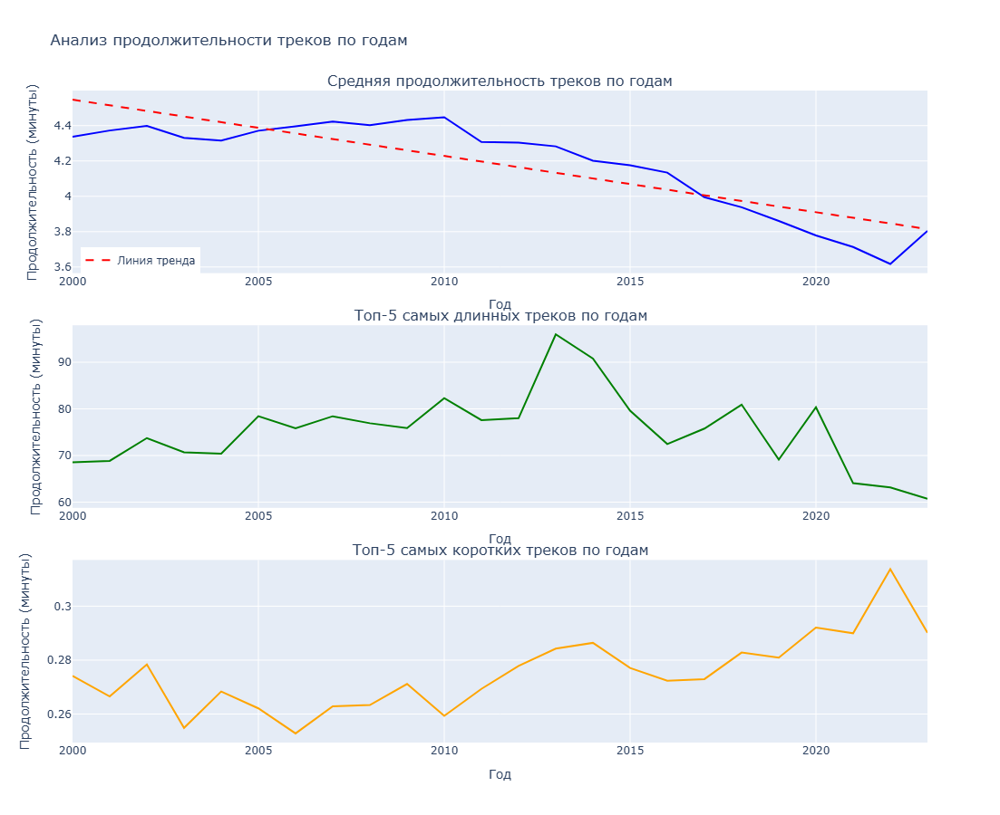

In [56]:
# YOUR CODE HERE
year_avg = df.groupby('year')['duration_ms'].mean().reset_index()
year_avg['duration_min'] = year_avg['duration_ms'] / 60000

# Топ-5 самых длинных треков по годам
top5_long = df.groupby('year')['duration_ms'].apply(
    lambda x: x.nlargest(5).mean()
).reset_index()
top5_long.columns = ['year', 'avg_duration_long']
top5_long['avg_duration_long_min'] = top5_long['avg_duration_long'] / 60000

# Топ-5 самых коротких треков по годам
top5_short = df.groupby('year')['duration_ms'].apply(
    lambda x: x.nsmallest(5).mean()
).reset_index()
top5_short.columns = ['year', 'avg_duration_short']
top5_short['avg_duration_short_min'] = top5_short['avg_duration_short'] / 60000

fig = make_subplots(
    rows=3, cols=1,
    subplot_titles=[
        'Средняя продолжительность треков по годам',
        'Топ-5 самых длинных треков по годам', 
        'Топ-5 самых коротких треков по годам'
    ],
    vertical_spacing=0.08
)

# График 1: Средняя продолжительность
fig.add_trace(
    go.Scatter(x=year_avg['year'], y=year_avg['duration_min'], 
               mode='lines', line=dict(width=2, color='blue'),
               showlegend=False),
    row=1, col=1
)

slope, intercept, _, _, _ = stats.linregress(year_avg['year'], year_avg['duration_min'])
trend_years = np.array([year_avg['year'].min(), year_avg['year'].max()])
trend_values = slope * trend_years + intercept

fig.add_trace(
    go.Scatter(x=trend_years, y=trend_values, 
               mode='lines', name='Линия тренда',
               line=dict(dash='dash', color='red', width=2)),
    row=1, col=1
)

# График 2: Топ-5 самых длинных треков
fig.add_trace(
    go.Scatter(x=top5_long['year'], y=top5_long['avg_duration_long_min'],
               mode='lines', name='Топ-5 самых длинных',
               line=dict(width=2, color='green'),
               showlegend=False),
    row=2, col=1
)

# График 3: Топ-5 самых коротких треков
fig.add_trace(
    go.Scatter(x=top5_short['year'], y=top5_short['avg_duration_short_min'],
               mode='lines', name='Топ-5 самых коротких', 
               line=dict(width=2, color='orange'),
               showlegend=False),
    row=3, col=1
)

fig.update_layout(
    height=900,
    width=800,
    title_text="Анализ продолжительности треков по годам",
    showlegend=True,
    legend=dict(
        yanchor="top",
        y=0.76,
        xanchor="left",
        x=0.01
    )
)

fig.update_xaxes(title_text="Год", row=1, col=1)
fig.update_yaxes(title_text="Продолжительность (минуты)", row=1, col=1)

fig.update_xaxes(title_text="Год", row=2, col=1)
fig.update_yaxes(title_text="Продолжительность (минуты)", row=2, col=1)

fig.update_xaxes(title_text="Год", row=3, col=1)
fig.update_yaxes(title_text="Продолжительность (минуты)", row=3, col=1)

fig.show()

### 3. Как менялись популярные жанры от 2000 от 2023? 

**Результат**: Код, реализующий график:
- 3 самых популярных по среднему значению жанра каждого года, с подписью значений

График должен иметь название, подписанные оси и подпись значений

**Дополнительно**: Текстовый ответ, какие жанры оказывались в топ-3 чаще всего.

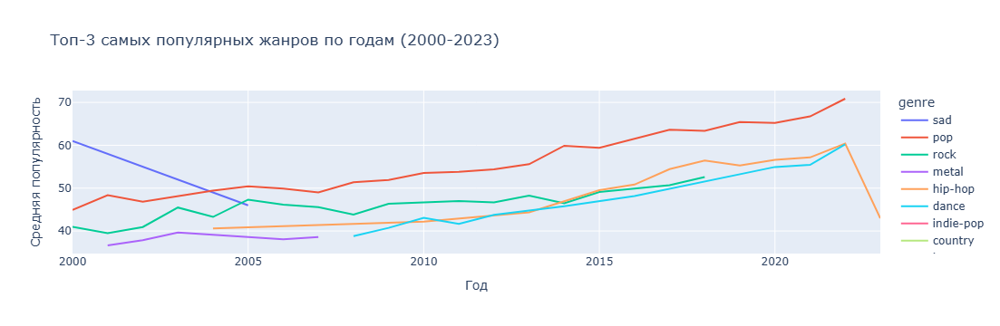

Жанры, чаще всего попадавшие в топ-3:
genre
pop        22
rock       17
hip-hop    12
dance      11
metal       5
Name: count, dtype: int64


In [59]:
# YOUR CODE HERE
df_recent = df[df['year'] >= 2000]

# Средняя популярность по жанрам и годам
genre_pop = df_recent.groupby(['year', 'genre'])['popularity'].mean().reset_index()

# Топ-3 жанра каждого года
top3_genres = []
for year in genre_pop['year'].unique():
    year_data = genre_pop[genre_pop['year'] == year]
    top3_year = year_data.nlargest(3, 'popularity')
    top3_genres.append(top3_year)

top3_genres = pd.concat(top3_genres, ignore_index=True)

fig = px.line(top3_genres, x='year', y='popularity', color='genre',
              title='Топ-3 самых популярных жанров по годам (2000-2023)',
              labels={'popularity': 'Средняя популярность', 'year': 'Год'})
fig.show()

# Какие жанры чаще всего в топ-3
top_genre_counts = top3_genres['genre'].value_counts()
print("Жанры, чаще всего попадавшие в топ-3:")
print(top_genre_counts.head(5))

### 4. Как связаны между собой Speechiness, Acousticness и Instrumentalness?

**Результат**: Код, реализующий 2 различных по типу графика. Выбранные графики должны наиболее хорошо подходить для описания зависимости между указанными параметрами.

Каждый график должен иметь название, подписанные оси и, при необходимости, легенду.

**Дополнительно**: Текстовый ответ, почему были выбраны именно такие графики.

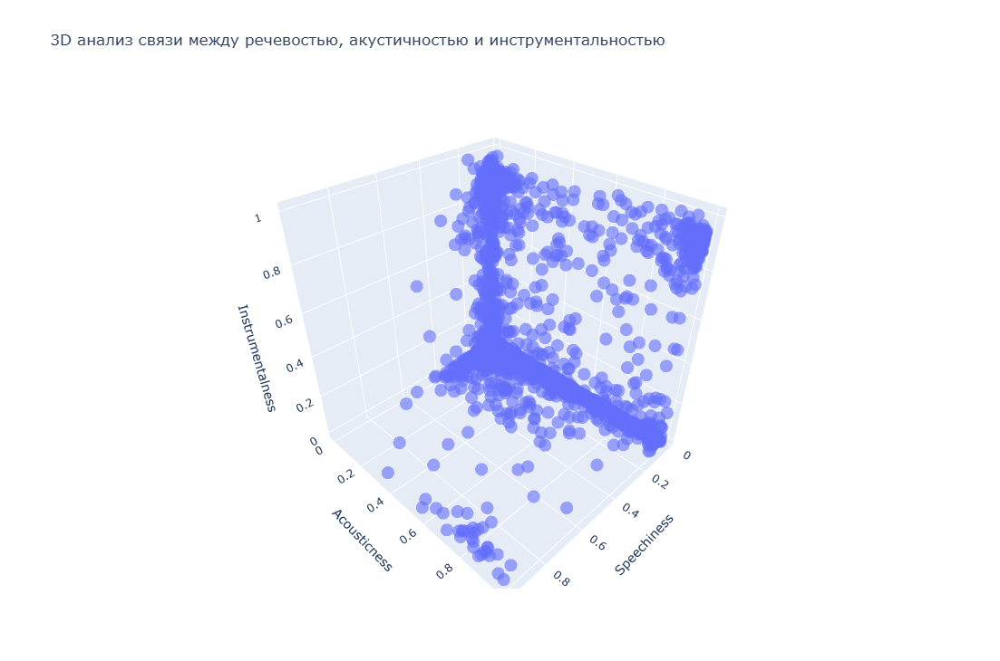

<Figure size 1200x1000 with 0 Axes>

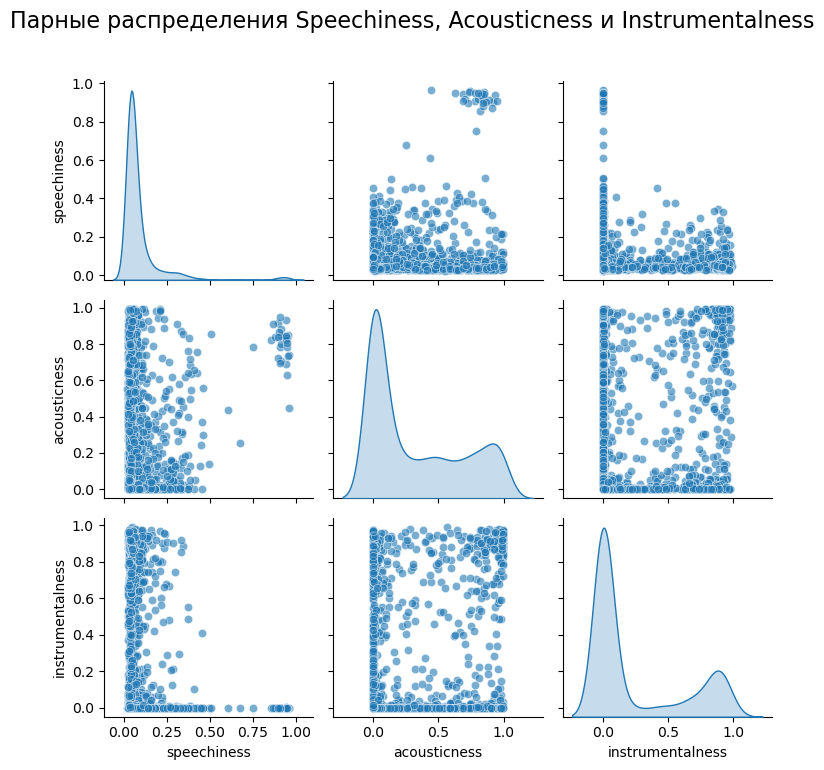

Обоснование выбора графиков:

1. 3D Scatter Plot:
   - Позволяет увидеть трехмерные кластеры и outliers
   - Хорошо показывает, как сочетаются все три параметра одновременно
   - Недостаток: сложно точно определить координаты точек

2. Pairplot:
   - Показывает ВСЕ парные отношения в одной фигуре
   - Диагональ показывает распределение каждого параметра
   - Точечные графики показывают парные корреляции
   - Гистограммы/KDE показывают распределения



In [72]:
# YOUR CODE HERE
# График 1: 3D scatter plot
fig1 = px.scatter_3d(df.sample(2000), 
                     x='speechiness', 
                     y='acousticness', 
                     z='instrumentalness',
                     title='3D анализ связи между речевостью, акустичностью и инструментальностью',
                     opacity=0.6,
                     height=730,
                     width=1000,
                     labels={
                         'speechiness': 'Speechiness',
                         'acousticness': 'Acousticness', 
                         'instrumentalness': 'Instrumentalness'
                     })
fig1.update_layout(font=dict(size=12))
fig1.show()

# График 2: Pairplot
sample_df = df[['speechiness', 'acousticness', 'instrumentalness']].sample(2000)

plt.figure(figsize=(12, 10))
sns.pairplot(sample_df, diag_kind='kde', plot_kws={'alpha': 0.6})
plt.suptitle('Парные распределения Speechiness, Acousticness и Instrumentalness', 
             y=1.02, fontsize=16)
plt.tight_layout()
plt.show()

print("Обоснование выбора графиков:\n")
print("1. 3D Scatter Plot:")
print("   - Позволяет увидеть трехмерные кластеры и outliers")
print("   - Хорошо показывает, как сочетаются все три параметра одновременно")
print("   - Недостаток: сложно точно определить координаты точек\n")

print("2. Pairplot:")
print("   - Показывает ВСЕ парные отношения в одной фигуре")
print("   - Диагональ показывает распределение каждого параметра")
print("   - Точечные графики показывают парные корреляции")
print("   - Гистограммы/KDE показывают распределения\n")

### 5. Какое влияние размер и лад оказывают на популярность в разных жанрах?

**Результат**: Код, реализующий фигуру:

- Жанры для сравнения: deep-house, funk, forro, dancehall, house.
- Точечный график для каждого жанра, отражающий среднюю популярность в зависимости от размера (time_signature) и лада (mode).

Фигура должна иметь название и легенду, каждый график имеет подписанные оси и название.

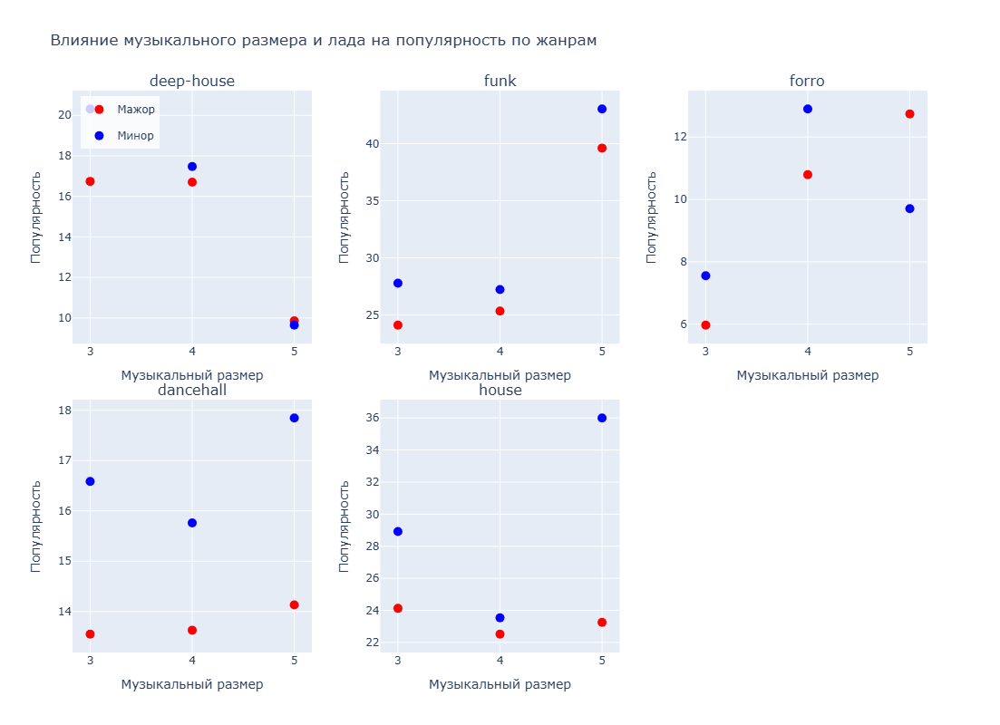

In [81]:
# YOUR CODE HERE
genres = ['deep-house', 'funk', 'forro', 'dancehall', 'house']
genre_df = df[df['genre'].isin(genres)]

# Средняя популярность по жанрам, размеру и ладу
pop_analysis = genre_df.groupby(['genre', 'time_signature', 'mode'])['popularity'].mean().reset_index()

fig = make_subplots(
    rows=2, cols=3,
    subplot_titles=genres,
    vertical_spacing=0.1,
    horizontal_spacing=0.08
)

for i, genre in enumerate(genres):
    row = i // 3 + 1
    col = i % 3 + 1
    
    genre_data = pop_analysis[pop_analysis['genre'] == genre]

    major_data = genre_data[genre_data['mode'] == 1]
    fig.add_trace(
        go.Scatter(
            x=major_data['time_signature'],
            y=major_data['popularity'],
            mode='markers',
            marker=dict(size=10, color='red', symbol='circle'),
            name='Мажор' if i == 0 else '',
            legendgroup='major',
            showlegend=i == 0
        ),
        row=row, col=col
    )

    minor_data = genre_data[genre_data['mode'] == 0]
    fig.add_trace(
        go.Scatter(
            x=minor_data['time_signature'],
            y=minor_data['popularity'],
            mode='markers',
            marker=dict(size=10, color='blue', symbol='circle'),
            name='Минор' if i == 0 else '',
            legendgroup='minor',
            showlegend=i == 0
        ),
        row=row, col=col
    )

fig.update_layout(
    height=800,
    width=1200,
    title_text="Влияние музыкального размера и лада на популярность по жанрам",
    showlegend=True,
    legend=dict(
        yanchor="top",
        y=0.99,
        xanchor="left",
        x=0.01,
        bgcolor='rgba(255,255,255,0.8)'
    )
)

for i in range(1, 6):
    fig.update_xaxes(
        title_text="Музыкальный размер",
        row=(i-1)//3+1,
        col=(i-1)%3+1,
        tickmode='linear',
        dtick=1
    )
    fig.update_yaxes(
        title_text="Популярность",
        row=(i-1)//3+1,
        col=(i-1)%3+1
    )

fig.show()

### 6. Как выглядят графики плотности распределения, построенные для темпа по уникальным значениям размера трека? Как выглядят графики плотности нормальных распределений по этим данным?
**Результат**: Код, реализующий графики распределения темпа (tempo) для всех уникальных значений размера трека (time_signature).

Фигура должна иметь название и легенду. Плотности распределения должны быть построены либо на одном графике, либо на нескольких графиках, но в рамках одной фигуры. Плотности нормального распределения должны быть построены в одной на одном графике с плотностью распределения tempo.

**Дополнительно**: Код с ответом на вопрос, какие параметры (среднее и разброс) для нормальных распределений темпа для размера трека.

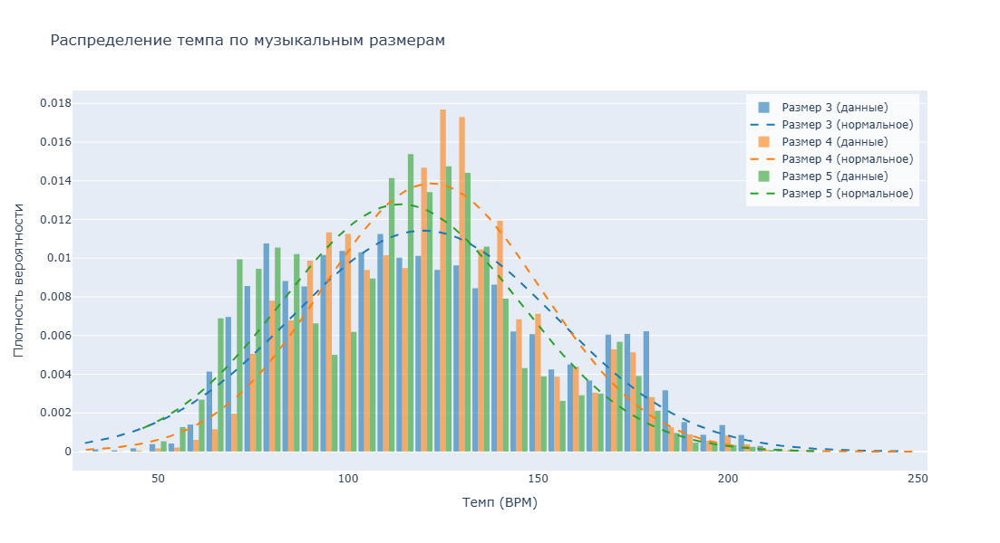

Параметры нормальных распределений темпа для каждого размера:
Размер 3: среднее = 119.91 BPM, стандартное отклонение = 34.93
Размер 4: среднее = 122.00 BPM, стандартное отклонение = 28.78
Размер 5: среднее = 113.83 BPM, стандартное отклонение = 31.21


In [86]:
# YOUR CODE HERE
time_sigs = sorted(df['time_signature'].unique())

fig = go.Figure()

colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd']

for i, ts in enumerate(time_sigs):
    tempo_data = df[df['time_signature'] == ts]['tempo'].dropna()
    
    # Параметры нормального распределения
    mean_tempo = tempo_data.mean()
    std_tempo = tempo_data.std()
    
    # Гистограмма с плотностью
    fig.add_trace(go.Histogram(
        x=tempo_data,
        histnorm='probability density',
        name=f'Размер {ts} (данные)',
        opacity=0.6,
        marker_color=colors[i % len(colors)],
        nbinsx=50,
        showlegend=True
    ))
    
    # Нормальное распределение
    x_norm = np.linspace(tempo_data.min(), tempo_data.max(), 100)
    y_norm = stats.norm.pdf(x_norm, mean_tempo, std_tempo)
    
    fig.add_trace(go.Scatter(
        x=x_norm,
        y=y_norm,
        mode='lines',
        name=f'Размер {ts} (нормальное)',
        line=dict(color=colors[i % len(colors)], dash='dash', width=2),
        showlegend=True
    ))

fig.update_layout(
    title='Распределение темпа по музыкальным размерам',
    xaxis_title='Темп (BPM)',
    yaxis_title='Плотность вероятности',
    height=600,
    width=900,
    bargap=0.1,
    legend=dict(
        yanchor="top",
        y=0.99,
        xanchor="right",
        x=0.99,
        bgcolor='rgba(255,255,255,0.8)'
    )
)

fig.show()

print("Параметры нормальных распределений темпа для каждого размера:")
for ts in time_sigs:
    tempo_data = df[df['time_signature'] == ts]['tempo'].dropna()
    mean_tempo = tempo_data.mean()
    std_tempo = tempo_data.std()
    print(f"Размер {ts}: среднее = {mean_tempo:.2f} BPM, стандартное отклонение = {std_tempo:.2f}")

### 7. Проанализируйте популярность одного артиста (группы) с 10-100 треками на Ваш выбор. 

**Результат**: Код, реализующий следующие графики:

- График, отражающий динамику суммарной популярности артиста год от года. Укажите стрелками с подписями, благодаря каким треками артист был на пике и на дне популярности.
- Сопоставьте признаки для этих двух треков, в виде графиков на Ваш выбор. Укажите, какие из признаков вероятнее всего оказали наибольшее влияние на популярность выбранных треков.

Графики должны находится в одной фигуре, имеющей название. Каждый график должен иметь название, подписанные оси и, при необходимости, легенду.

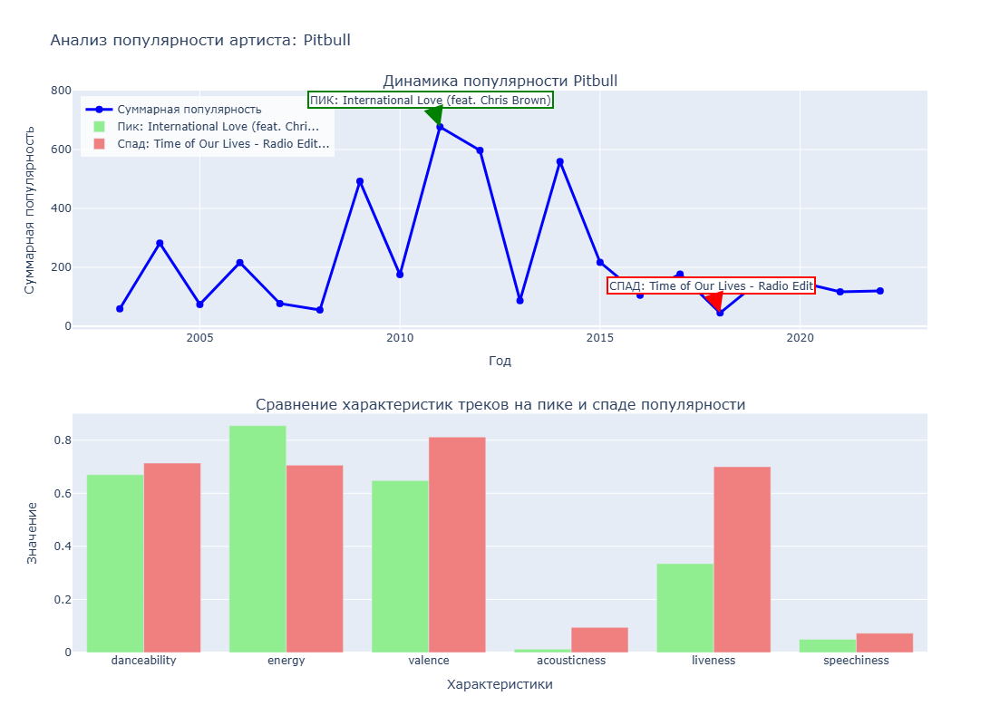

Признаки, оказавшие больше всего влияния на популярность пика и спада:
  liveness: 0.335 (пик) vs 0.700 (спад) - разница: 0.365
  valence: 0.648 (пик) vs 0.812 (спад) - разница: 0.164
  energy: 0.855 (пик) vs 0.706 (спад) - разница: 0.149


In [89]:
# YOUR CODE HERE
artist_name = "Pitbull"
artist_df = df[df['artist_name'] == artist_name].copy()

# Суммарная популярность по годам
yearly_pop = artist_df.groupby('year')['popularity'].sum().reset_index()

# Пик и спад популярности
peak_idx = yearly_pop['popularity'].idxmax()
low_idx = yearly_pop['popularity'].idxmin()

peak_year = yearly_pop.loc[peak_idx]
low_year = yearly_pop.loc[low_idx]

# Треки на пике и спаде
peak_track = artist_df[artist_df['year'] == peak_year['year']].nlargest(1, 'popularity').iloc[0]
low_track = artist_df[artist_df['year'] == low_year['year']].nlargest(1, 'popularity').iloc[0]

fig = make_subplots(
    rows=2, cols=1,
    subplot_titles=[
        f'Динамика популярности {artist_name}',
        'Сравнение характеристик треков на пике и спаде популярности'
    ],
    vertical_spacing=0.15
)

# График 1: Динамика популярности
fig.add_trace(
    go.Scatter(x=yearly_pop['year'], y=yearly_pop['popularity'],
              mode='lines+markers', name='Суммарная популярность',
              line=dict(width=3, color='blue'), marker=dict(size=8)),
    row=1, col=1
)

# Стрелка пика популярности
fig.add_annotation(
    x=peak_year['year'], y=peak_year['popularity'],
    text=f"ПИК: {peak_track['track_name']}",
    showarrow=True,
    arrowhead=2,
    arrowsize=1.5,
    arrowwidth=3,
    arrowcolor="green",
    bgcolor="white",
    bordercolor="green",
    borderwidth=2,
    row=1, col=1
)

# Стрелка спада популярности
fig.add_annotation(
    x=low_year['year'], y=low_year['popularity'],
    text=f"СПАД: {low_track['track_name']}",
    showarrow=True,
    arrowhead=2,
    arrowsize=1.5,
    arrowwidth=3,
    arrowcolor="red",
    bgcolor="white", 
    bordercolor="red",
    borderwidth=2,
    row=1, col=1
)

# График 2: Сравнение характеристик треков
features = ['danceability', 'energy', 'valence', 'acousticness', 'liveness', 'speechiness']

peak_values = [peak_track[feature] for feature in features]
low_values = [low_track[feature] for feature in features]

fig.add_trace(
    go.Bar(name=f'Пик: {peak_track["track_name"][:30]}...', x=features, y=peak_values,
           marker_color='lightgreen'),
    row=2, col=1
)

fig.add_trace(
    go.Bar(name=f'Спад: {low_track["track_name"][:30]}...', x=features, y=low_values,
           marker_color='lightcoral'),
    row=2, col=1
)

fig.update_layout(
    height=800,
    width=1000,
    title_text=f"Анализ популярности артиста: {artist_name}",
    showlegend=True,
    legend=dict(
        yanchor="top",
        y=0.99,
        xanchor="left", 
        x=0.01,
        bgcolor='rgba(255,255,255,0.8)'
    )
)

fig.update_xaxes(title_text="Год", row=1, col=1)
fig.update_yaxes(title_text="Суммарная популярность", row=1, col=1)
fig.update_xaxes(title_text="Характеристики", row=2, col=1)
fig.update_yaxes(title_text="Значение", row=2, col=1)

fig.show()

# Анализ влияния характеристик
diff_features = {}
for feature in features:
    diff = abs(peak_track[feature] - low_track[feature])
    diff_features[feature] = diff

top_diff = sorted(diff_features.items(), key=lambda x: x[1], reverse=True)[:3]
print(f"Признаки, оказавшие больше всего влияния на популярность пика и спада:")
for feature, diff in top_diff:
    print(f"  {feature}: {peak_track[feature]:.3f} (пик) vs {low_track[feature]:.3f} (спад) - разница: {diff:.3f}")